In [ ]:
########################################################################
# Author    : A. Alsema
# Date      : May-July 2021
# Dataset   : Visium Spatial Transcriptomics for MS lesions
# Purpose   : organize and filter data, we use clustering to remove the contaminating GM areas within WM sections
# Required input: "2.WM.integrated_scaled.rds"
#########################################################################

In [1]:
rm(list = ls())

library(Seurat)
library(hdf5r)
library(ggplot2)
library(patchwork)
library(future)
library(dplyr)
library(RColorBrewer)
# Enable parallelization
options(future.globals.maxSize = 3000 * 1024^2, future.seed = TRUE)
plan("multicore", workers = 25)

ggplot.theme <- theme(aspect.ratio = 1,
                    text = element_text(hjust = 0.5, face = "plain", size = (9)),
                    plot.title = element_text(hjust = 0.5, face = "plain", size = (10)),
                    axis.title.x = element_text(face = "plain", size = (12)),
                    axis.title.y = element_text(face = "plain", size = (12)),
                    axis.text = element_text(face = "plain", size = (12), colour = "black"),
#                     axis.text.x = element_text(angle = 90, vjust=0.5, hjust=1),
                    plot.subtitle = element_text(hjust = 0.5),
                    panel.background = element_blank(),
                    panel.border = element_blank(),
                    panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
                    panel.grid = element_blank(),
                    axis.line = element_line(color = "black"),
                    plot.background = element_rect(fill="transparent", color=NA),
                    legend.key = element_rect(fill="transparent", color="transparent"),
                    legend.box.background = element_rect(fill="transparent", color="transparent"),
                    legend.background = element_rect(fill="transparent", color="transparent"),
                    legend.text=element_text(size=10), 
                    legend.title = element_text(size=10))

Attaching SeuratObject

Seurat v4 was just loaded with SeuratObject v5; disabling v5 assays and
validation routines, and ensuring assays work in strict v3/v4
compatibility mode


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Warning message:
“package ‘RColorBrewer’ was built under R version 4.2.1”


# Filter spots with low-content and prepare data

In [ ]:
################################## prepare data -- only once ##################################

st.integrated <- readRDS("./RData/seurat/2.WM.integrated_scaled.rds")

# pre-filtering of low-content spots
print("dim before the low-content spots are removed") 
dim(st.integrated)
st.integrated <- subset(st.integrated, subset = nFeature_Spatial > 100 & nCount_Spatial > 100) # percent mito is higher in some lesions, therefore could be biological, not a QC filter.

print("dim after the low-content spots are removed") 
dim(st.integrated)

## 1831 spots are removed from the object

## without removal of low-content spots i got 3 or 4 low content clusters

In [ ]:
# check the metadata
unique(st.integrated$Group)
unique(st.integrated$sample_ID)

table(st.integrated$sample_name, st.integrated$Group) # note: activeWML_2011_077 sample has provided two sections/active lesions.

In [ ]:
# update the metadata
st.integrated$Group <- factor(st.integrated$Group, levels = c("CWM", "NAWM", "activeWML", "Mixed_active-inactive"),
                                                    labels = c("CWM", "NAWM", "active", "act/inact") )
# order the donors in groups
st.integrated$sample_ID <- factor(st.integrated$sample_ID, levels = c("ST31", "ST32",
                                                                      "ST34", "ST37", "ST38",
                                                         "ST33", "ST69", "ST70", "ST79", 
                                                         "ST67", "ST68", "ST71", "ST72", "ST73", "ST74"))
st.integrated$manuscript_ID <- factor(st.integrated$manuscript_ID, levels = c("C1", "C2", "N1", "N2", "N3", "A1", "A2", "A3", "A4", "M1", "M2", "M3", "M4", "M5", "M6" ) )
st.integrated$orig.ident <- paste(st.integrated$sample_ID, st.integrated$Group, sep = "_")

## add the ribo and mito stuff - only once
st.integrated[["percent.mito"]] <- PercentageFeatureSet(st.integrated, assay = "Spatial", pattern = "^MT-")
st.integrated[["percent.ribo"]] <- PercentageFeatureSet(st.integrated, assay = "Spatial", pattern = "^RPS|^RPL")

# Dim Red

In [ ]:
# scale data again
gc()
st.integrated <- ScaleData(st.integrated, vars.to.regress = c("nFeature_Spatial")) # tested but NOT useful vars.to.regress = c("nCount_Spatial"). 
# Run PCA
DefaultAssay(st.integrated) <- "integrated"
gc()
st.integrate <- RunPCA(st.integrated)
ElbowPlot(st.integrated, ndims = 50)
saveRDS(st.integrated, file = "./RData/seurat/2.WM.integrated_scaled_filtered.rds")

In [ ]:
# st.integrated <- readRDS(file = "./RData/seurat/2.WM.integrated_scaled_filtered.rds")
# some custom colors for the group
group_cols <- c("#80C280", "#B36F9F",  "#5D8BBB", "#FF4D4D", "#FFB55E", "#F3F280")
names(group_cols) <- levels(st.integrated$Group) # important for the PCA plot in figure 1c!
group_cols
dir.create("Routput/Seurat/R_QC", recursive = TRUE)
dir.create("Routput/Seurat/Clustering", recursive = TRUE)

## optional QC plots

In [ ]:
x <- table(st.integrated$sample_ID)
x
tiff('./Routput/Seurat/Clustering/spots analysed per sample.tiff')
plot(x, las = 2, ylab = "spots analysed")
dev.off()
write.csv(x, "./Routput/Seurat/Clustering/spots analysed per sample.csv")

x <- table(st.integrated$sample_name)
tiff('./Routput/Seurat/Clustering/spots analysed per donor.tiff')
plot(x, las = 2, ylab = "spots analysed")
dev.off()
write.csv(x, "./Routput/Seurat/Clustering/spots analysed per donor.csv")

In [ ]:
print('average spots per ST sample ID:')
print(mean(table(st.integrated$sample_ID)))
print('total spots analysed')
print(ncol(st.integrated))

In [ ]:
tiff("Routput/Seurat/R_QC/QC_cor_brainpH_RIN.tiff", units = "in", res = 300, height = 10, width = 10)
FeatureScatter(st.integrated, feature1 = "RIN", feature2 = 'brain_pH')
dev.off()

p1 <- VlnPlot(st.integrated, features = "nCount_Spatial", group.by = "manuscript_ID", pt.size = 0) 
p1 <- p1 + stat_summary(fun = mean, geom = "point", size = 2, color = 'black') + NoLegend() + 
                ggtitle("Counts per ST sample") 

p2 <- VlnPlot(st.integrated, features = "nCount_Spatial", group.by = "Group", pt.size = 0, 
              cols = group_cols) 
p2 <- p2 + stat_summary(fun = mean, geom = "point", size = 2, color = 'black') + NoLegend() + 
                ggtitle("Counts per Group")

p3 <- VlnPlot(st.integrated, features = "nCount_Spatial", group.by = "slide", pt.size = 0) 
p3 <- p3 + stat_summary(fun = mean, geom = "point", size = 2, color = 'black') + NoLegend() + 
                ggtitle("Counts per slide")

p4 <- VlnPlot(st.integrated, features = "nCount_Spatial", group.by = "sample_name", pt.size = 0) 
p4 <- p4 + stat_summary(fun = mean, geom = "point", size = 2, color = 'black') + NoLegend() + 
                ggtitle("Counts per donor")

pdf("Routput/Seurat/R_QC/nCount_QC.pdf", width = 7, height = 7)
wrap_plots(p1,p2,p3,p4, ncol = 2)
dev.off()

tiff("Routput/Seurat/R_QC/QC_plots_slide.tiff", units = "in", res = 300, height = 10, width = 10)
VlnPlot(st.integrated, features = c("nCount_Spatial", "nFeature_Spatial", "percent.mito", "percent.ribo"), ncol = 2, 
        group.by = "slide", pt.size = 0)
dev.off()

tiff("Routput/Seurat/R_QC/QC_plots_donors.tiff", units = "in", res = 300, height = 10, width = 10)
VlnPlot(st.integrated, features = c("nCount_Spatial", "nFeature_Spatial", "percent.mito", "percent.ribo"), ncol = 2, 
        group.by = "sample_name", pt.size = 0)
dev.off()

tiff("Routput/Seurat/R_QC/QC_plots_samples.tiff", units = "in", res = 300, height = 10, width = 10)
VlnPlot(st.integrated, features = c("nCount_Spatial", "nFeature_Spatial", "percent.mito", "percent.ribo"), ncol = 2, 
        group.by = "manuscript_ID", pt.size = 0)
dev.off()

In [ ]:
## make a nicer plot of the possible relation between RIN and nFeature/nCount

meta_full <- st.integrated@meta.data
meta_full$sample_ID <- as.character(meta_full$sample_ID)
require(dplyr)
meta_avg <- meta_full %>%
  group_by(sample_ID) %>%# Specify group indicator 
  summarise_at(vars(nCount_Spatial, nFeature_Spatial, percent.mito), 
               list(mean = mean)
               )  
meta_avg$RIN <- st.integrated@meta.data$RIN[!duplicated(st.integrated@meta.data$sample_ID)] 

print("Pearson correlation between RIN and average UMI count")
cor(meta_avg$RIN, meta_avg$nCount_Spatial_mean, method = "pearson")
print("Pearson correlation between RIN and average nr of detected genes")
cor(meta_avg$RIN, meta_avg$nFeature_Spatial_mean)
print("Pearson correlation between RIN and average percent mito")
cor(meta_avg$RIN, meta_avg$percent.mito_mean)

require(ggplot2)
pdf("Routput/Seurat/R_QC/QC_plot RIN.pdf")
ggplot(meta_avg, aes(x=RIN, y=nCount_Spatial_mean)) +
  geom_point(size=2, shape=23) + 
  ggplot.theme +
  geom_smooth(method=lm) +
  ylab("average UMI_counts") +
  scale_x_continuous(breaks = seq(6,9,1), limits=c(6, 9))

ggplot(meta_avg, aes(x=RIN, y=nFeature_Spatial_mean)) +
  geom_point(size=2, shape=23) + 
  ggplot.theme +
  geom_smooth(method=lm) +
  ylab("average nr of detected genes") +
  scale_x_continuous(breaks = seq(6,9,1), limits=c(6, 9))

ggplot(meta_avg, aes(x=RIN, y=percent.mito_mean)) +
  geom_point(size=2, shape=23) + 
  ggplot.theme +
  geom_smooth(method=lm) +
  ylab("average percent of mitochondrial transcripts") +
  scale_x_continuous(breaks = seq(6,9,1), limits=c(6, 9))
dev.off()

## better RIN value seems to correlate with lower % of mitochondrial transcripts

## 2. PCA plots

In [ ]:
table(st.integrated$Group)

In [ ]:
pdf("Routput/Seurat/Clustering/PCA_WM_geneloadings.pdf", width = 10, height = 20)
VizDimLoadings(st.integrated, dims = 1:6, reduction = "pca")
dev.off()


pdf('Routput/Seurat/Clustering/pca_WM_group.pdf')
DimPlot(st.integrated, reduction = "pca", group.by = "Group", order = c("CWM", "NAWM", "active", "act/inact"), cols = group_cols, dims = c(1,2))
DimPlot(st.integrated, reduction = "pca", group.by = "Group", order = c("CWM", "NAWM", "active", "act/inact"), cols = group_cols, dims = c(1,3))
dev.off()


pdf('Routput/Seurat/Clustering/pca_WM_donors.pdf')
DimPlot(st.integrated, reduction = "pca", group.by = "sample_name", dims = c(1,2))
dev.off()

pdf('Routput/Seurat/Clustering/pca_WM_slide.pdf')
DimPlot(st.integrated, reduction = "pca", group.by = "slide", dims = c(1,2))
dev.off()

## 3. Clustering

In [ ]:
# # find resolution options - only once
ndims = 20
k.parameter = 20
spots <- st.integrated

k = 1
n.clusters = NULL
for (i in seq(from = 0.1, to = 1.0, by = 0.1)){
    spots = FindNeighbors(spots, dims = 1:ndims, k.param = k.parameter) 
    spots = FindClusters(spots, resolution = i)
    n.clusters[k] = length(levels(spots$seurat_clusters))
    k = k + 1
}

# plot resolution options
df <- as.data.frame(n.clusters)
df$res <- seq(from = 0.1, to = 1.0, by = 0.1)
tiff("Routput/Seurat/Clustering/WM_Resolutions.tiff")
ggplot(df, aes(x= res, y = n.clusters)) +
    geom_point(size = 6, shape = 4) +
    scale_x_continuous(breaks = seq(from = 0, to = 1.0, by = 0.1)) +
    theme_minimal()
dev.off()

In [2]:
########################################################################
#			          UMAP  & Clustering                               #
########################################################################
# this part was repeated until i found the right settings (indicated below)
st.integrated <- readRDS(file = "./RData/seurat/2.WM.integrated_scaled_filtered.rds")
set.seed(1234)
ndims = 20
k.parameter = 20
res = 0.3 # chosen resolution
DefaultAssay(st.integrated) <- "integrated"

datasets <- FindNeighbors(object = st.integrated, dims = 1:ndims, k.param = k.parameter) 
datasets <- FindClusters(object = datasets, resolution = res, future.seed = TRUE)
datasets <- RunUMAP(datasets, dims = 1:ndims, verbose = F)

Computing nearest neighbor graph

Computing SNN

Warning message:
“The following arguments are not used: future.seed”
Warning message:
“The following arguments are not used: future.seed”


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 58271
Number of edges: 1576711

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8917
Number of communities: 13
Elapsed time: 13 seconds


3 singletons identified. 10 final clusters.

Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”
Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”


In [3]:
print(paste('we found' , length(levels(datasets@active.ident)), 'clusters' ))
table(datasets$seurat_clusters)

[1] "we found 10 clusters"



    0     1     2     3     4     5     6     7     8     9 
15509 15038  7746  7389  5299  4099  2116   447   439   189 

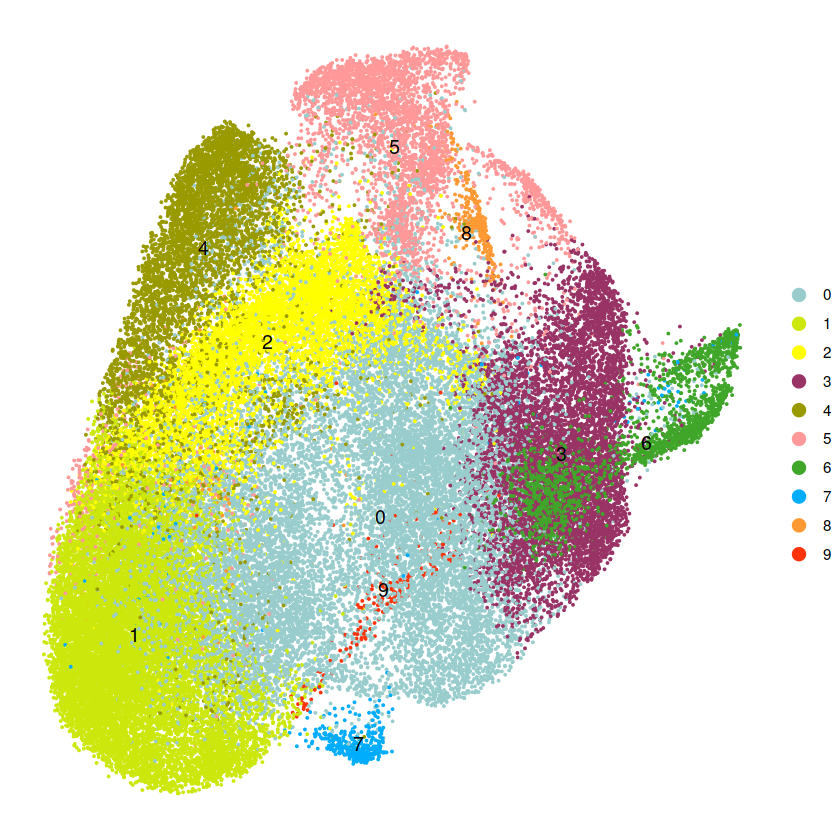

In [4]:
#--------------------- umap colors ---------------------
ucols<-c("#99CCCC", "#cce70b","#FFFF00", "#993366", "#999900", 
          "#FF9999" , "#40a629","#00acfc" , "#FF9933",  "#fe330a")
#          "#FFCC99" ) # "#999999", "#ff00ff", "#663300", "#0000CC",          
         #"#9996FF", "#9900CC", "#006666", "#66FF00")
# library("RColorBrewer")
# ucols <- brewer.pal(length(levels(datasets$seurat_clusters)), "Set2")

# ucols <- c("#C8D523", "#EC4895", "#D45A25", "#B11A20", "#1C3563", "#BEBDBE", "#2a6420")
names(ucols) <- levels(datasets@active.ident)

DimPlot(datasets, label = T, cols = ucols) + theme_void()

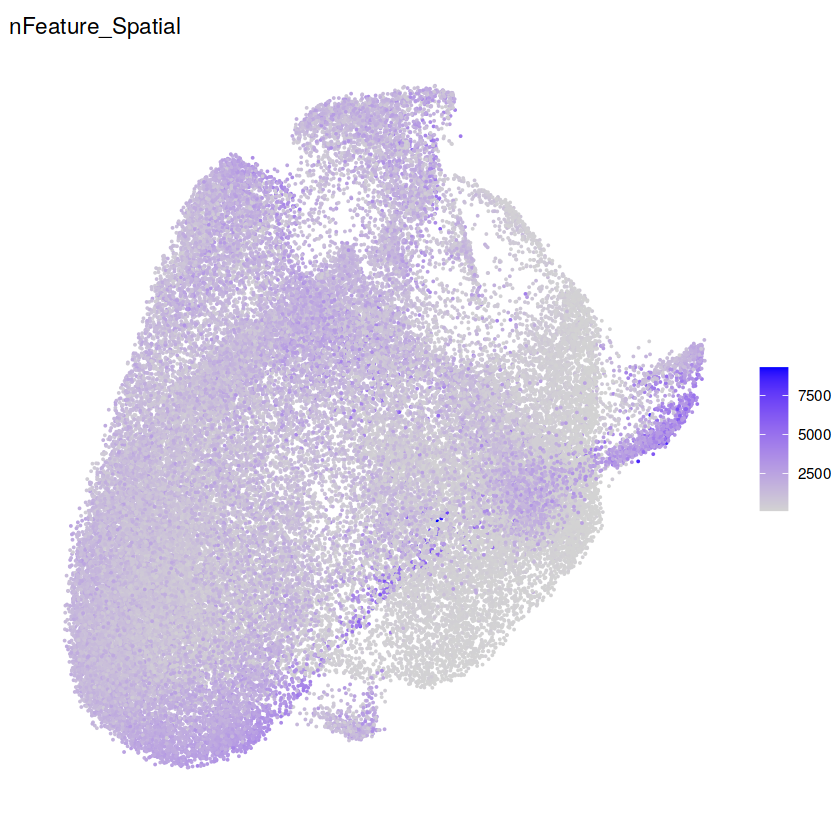

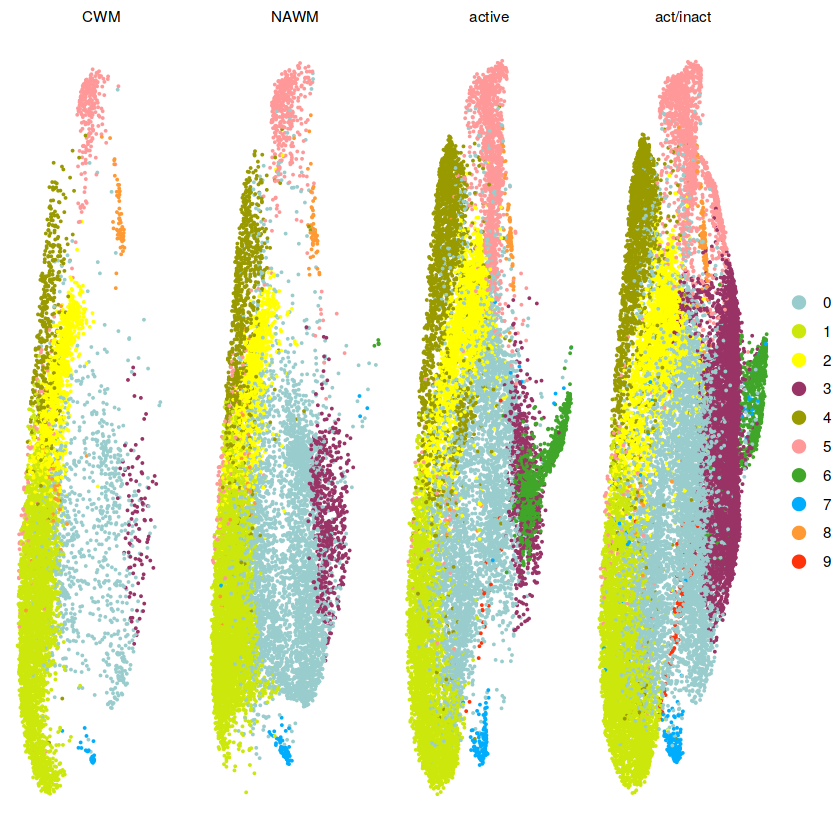

In [8]:
# investigate the clustering result
FeaturePlot(datasets, feature = "nFeature_Spatial")  + theme_void()

DimPlot(datasets, split.by = "Group", cols = ucols)  + theme_void()

DefaultAssay(datasets) <- "Spatial"

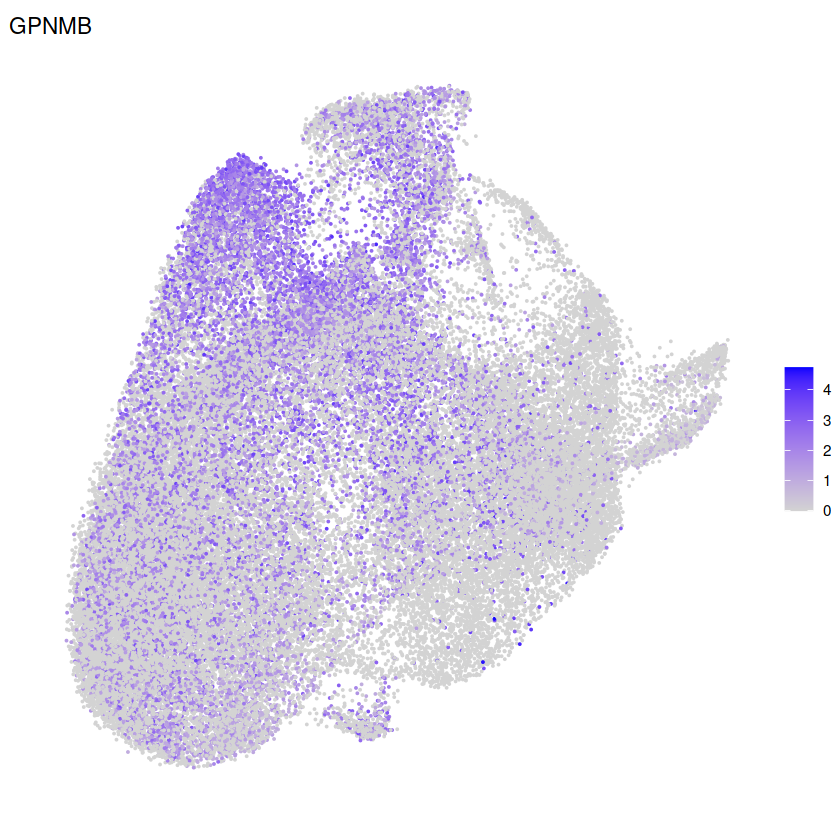

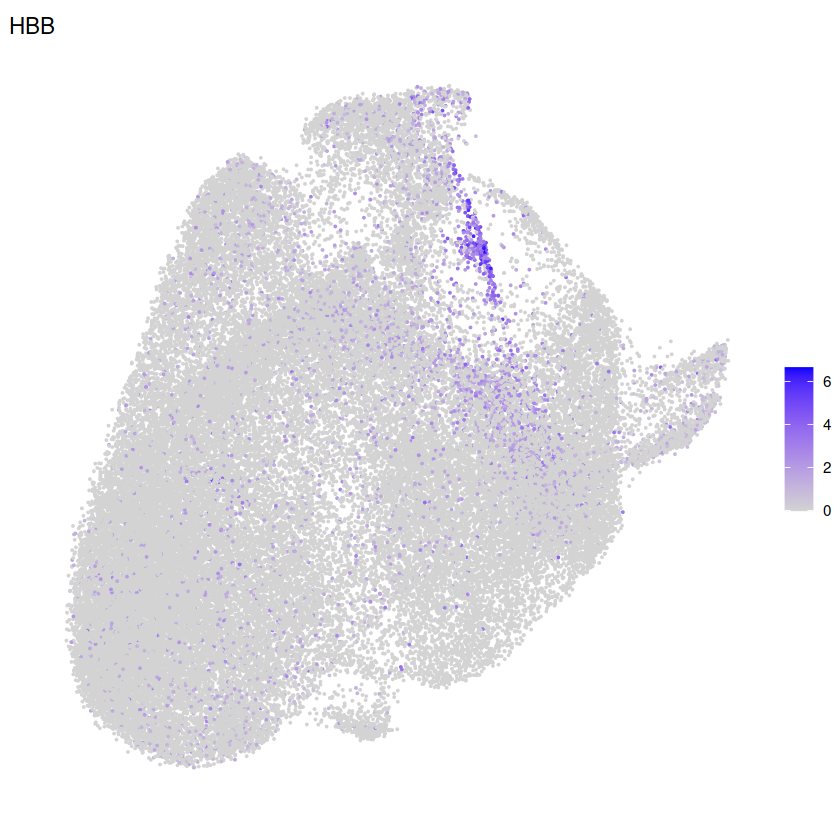

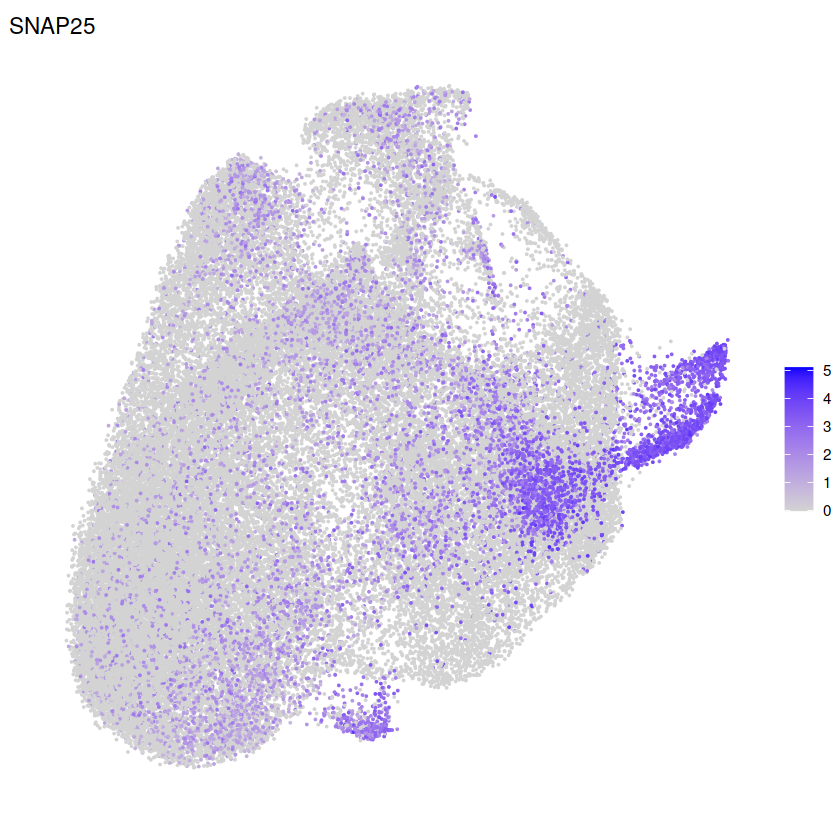

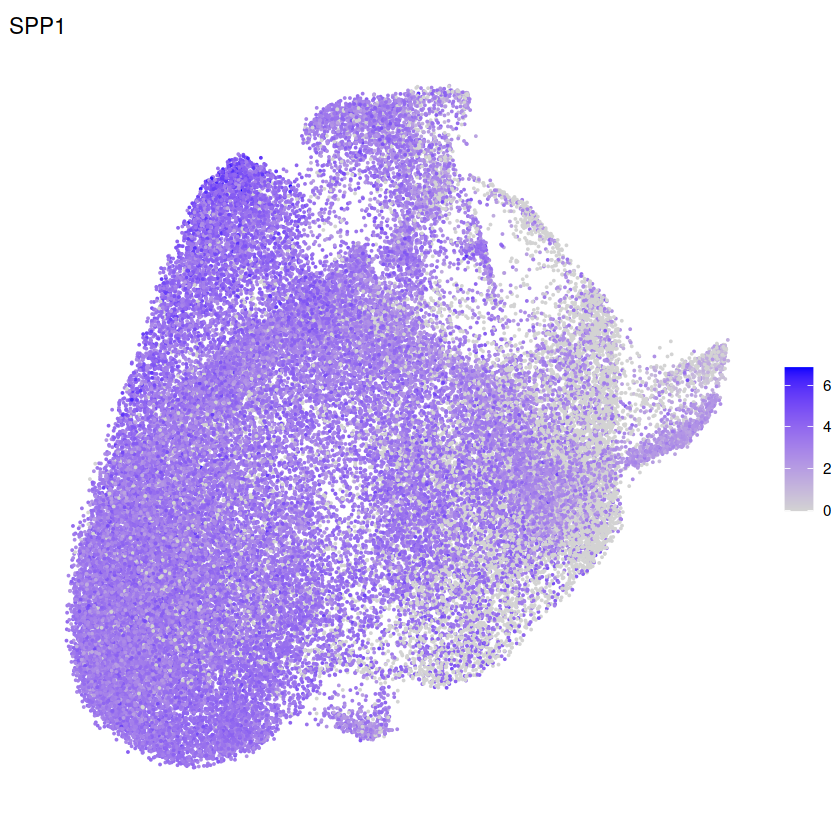

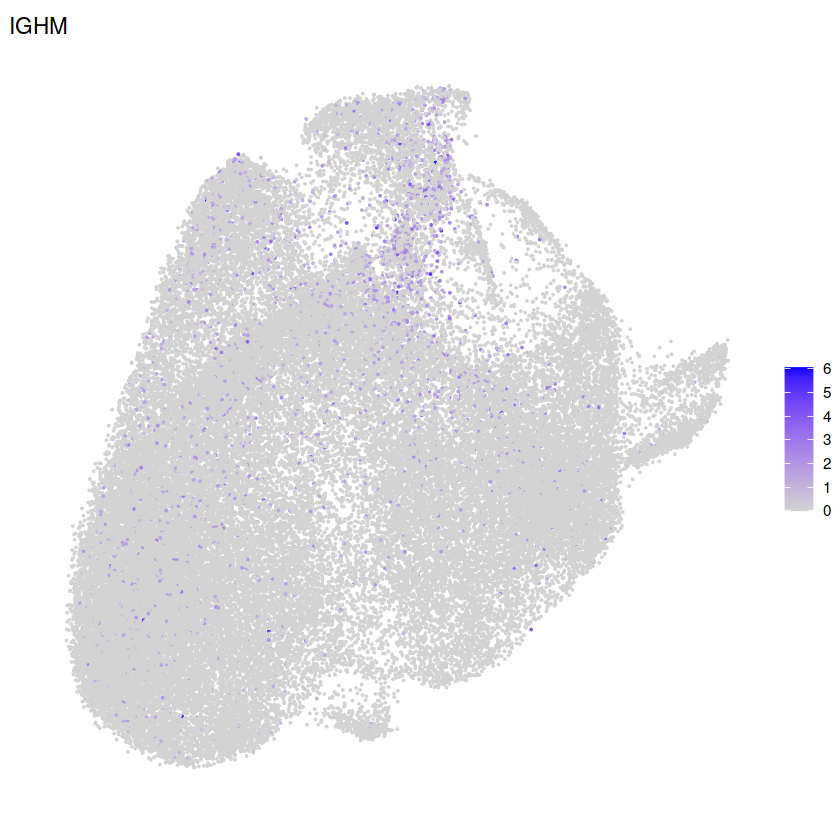

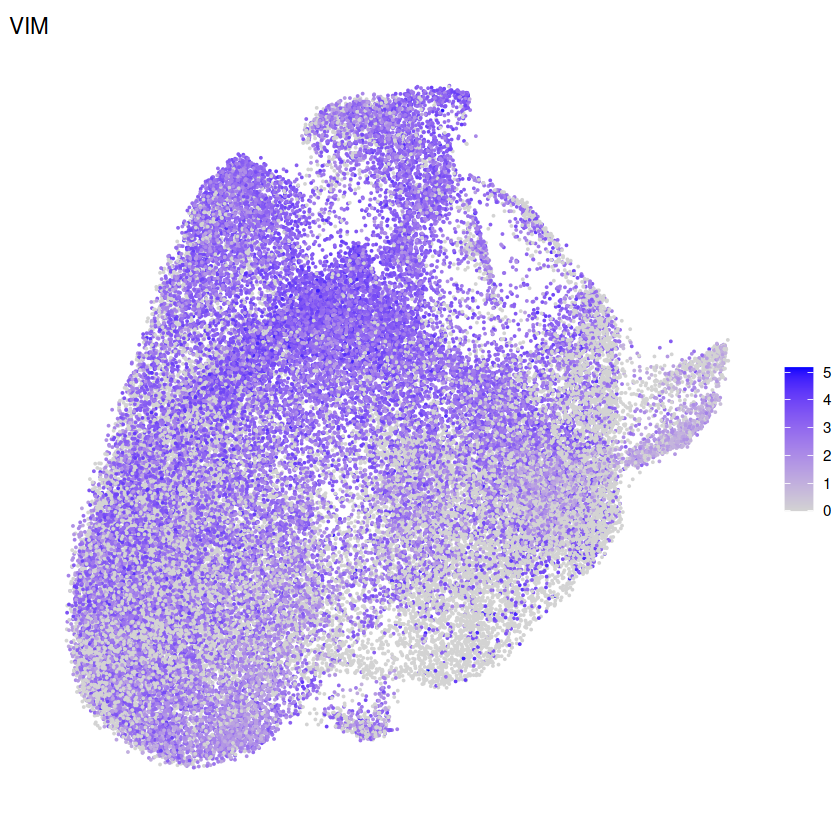

In [9]:
FeaturePlot(datasets, feature = "GPNMB", slot = "data")  + theme_void()
FeaturePlot(datasets, feature = "HBB", slot = "data")  + theme_void()
FeaturePlot(datasets, feature = "SNAP25", slot = "data")  + theme_void()
FeaturePlot(datasets, feature = "SPP1", slot = "data")  + theme_void()
FeaturePlot(datasets, feature = "IGHM", slot = "data")  + theme_void()
FeaturePlot(datasets, feature = "VIM", slot = "data")  + theme_void()

Warning message:
“Removed 10 rows containing missing values (`geom_segment()`).”
Warning message:
“Removed 10 rows containing missing values (`geom_segment()`).”
Warning message:
“Removed 10 rows containing missing values (`geom_segment()`).”
Warning message:
“Removed 10 rows containing missing values (`geom_segment()`).”


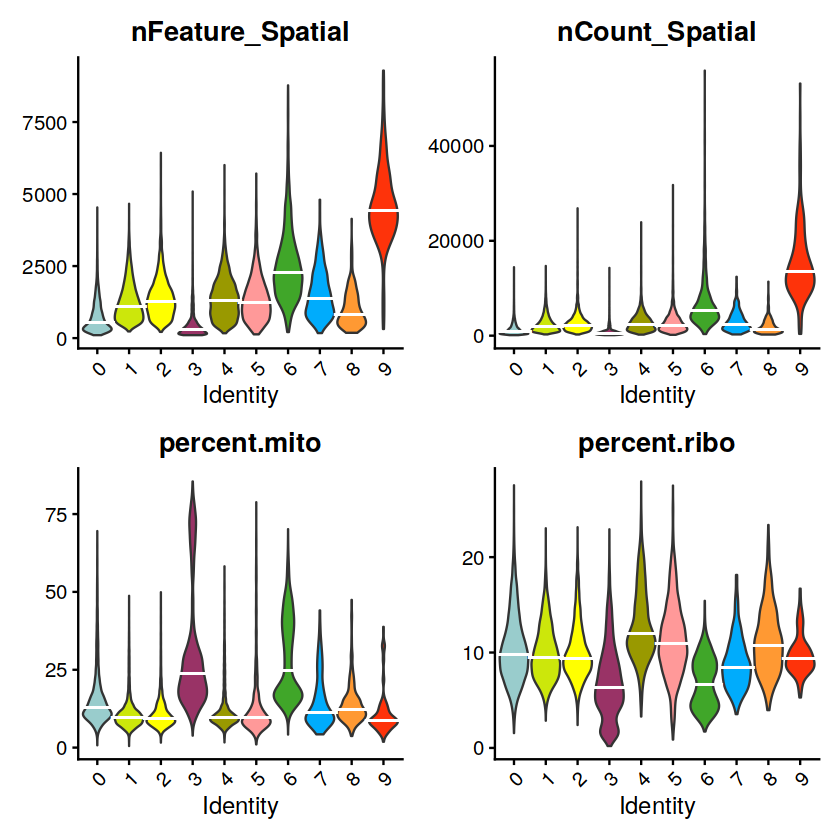

In [10]:
#######################################################################
#			          QC plots of clusters  	      		       #
#######################################################################
p1 <- VlnPlot(datasets, features = c('nFeature_Spatial'), pt.size = 0) # , y.max = 2000 ""
p1 <- p1 + 
        stat_summary(fun = median, shape = 95, size = 3, colour = 'white') +
        theme(legend.position = 'none') + 
        scale_fill_manual(values = ucols)

p2 <- VlnPlot(datasets, features = c('nCount_Spatial'), pt.size = 0) # ""
p2 <- p2 + 
        stat_summary(fun = median, shape = 95, size = 3, colour = 'white') +
        theme(legend.position = 'none') + 
        scale_fill_manual(values = ucols)

p3 <- VlnPlot(datasets, features = c('percent.mito'), pt.size = 0) # ""
p3 <- p3 + 
        stat_summary(fun = median, shape = 95, size = 3, colour = 'white') +
        theme(legend.position = 'none') + 
        scale_fill_manual(values = ucols)

p4 <- VlnPlot(datasets, features = c('percent.ribo'), pt.size = 0) # ""
p4 <- p4 + 
        stat_summary(fun = median, shape = 95, size = 3, colour = 'white') +
        theme(legend.position = 'none') + 
        scale_fill_manual(values = ucols)

wrap_plots(p1, p2, p3, p4)



[1] "ST31_CWM"       "ST32_CWM"       "ST33_active"    "ST34_NAWM"     
 [5] "ST37_NAWM"      "ST38_NAWM"      "ST67_act/inact" "ST68_act/inact"
 [9] "ST69_active"    "ST70_active"    "ST71_act/inact" "ST72_act/inact"
[13] "ST73_act/inact" "ST74_act/inact" "ST79_active"

[1] 15

[1] 15

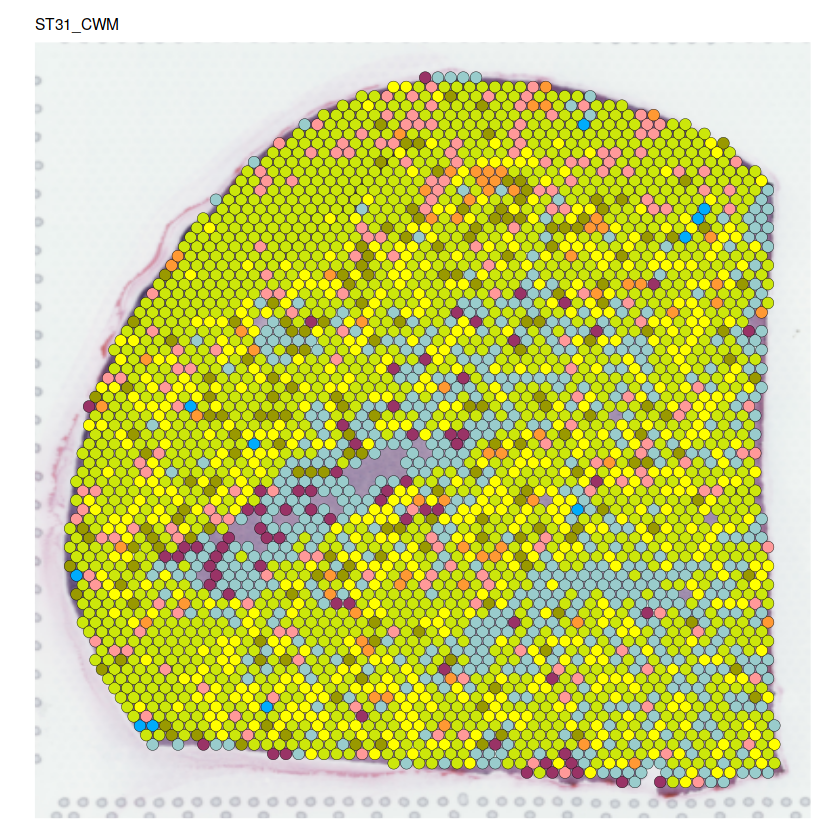

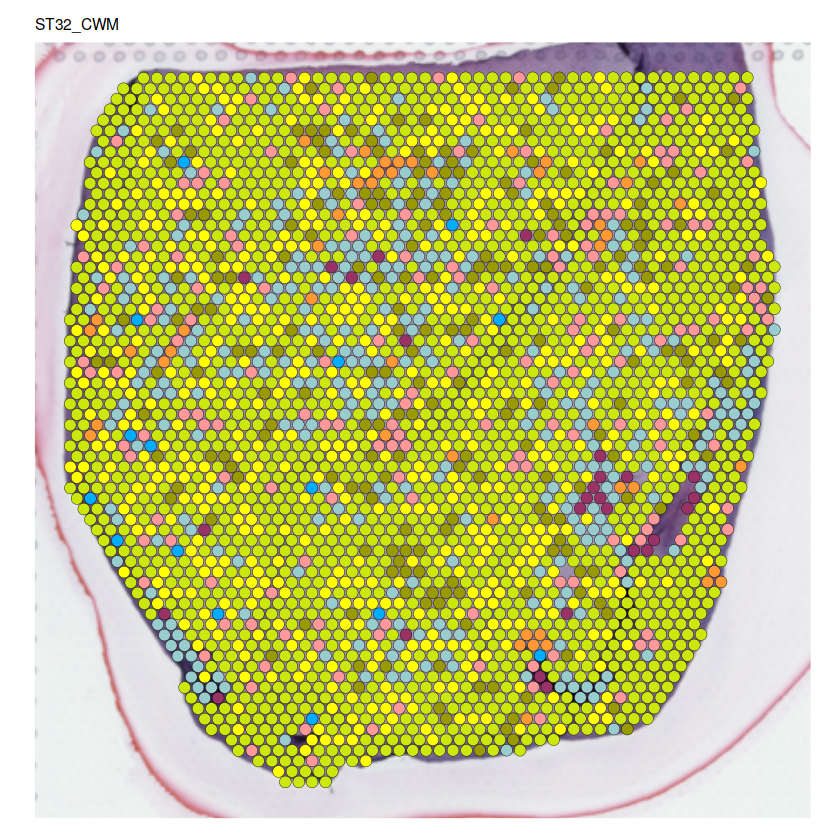

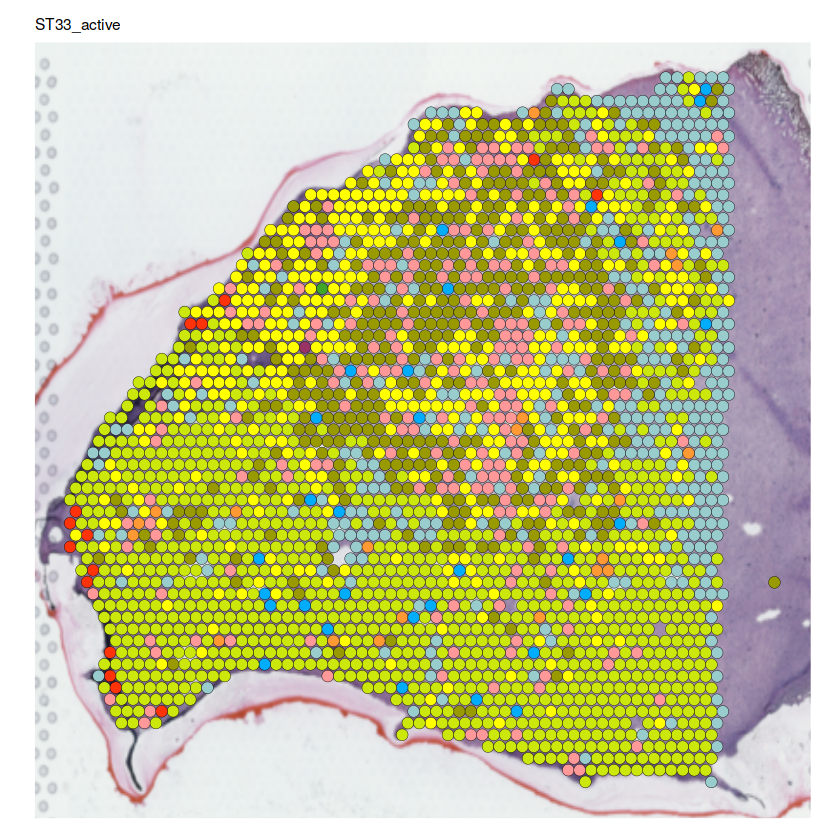

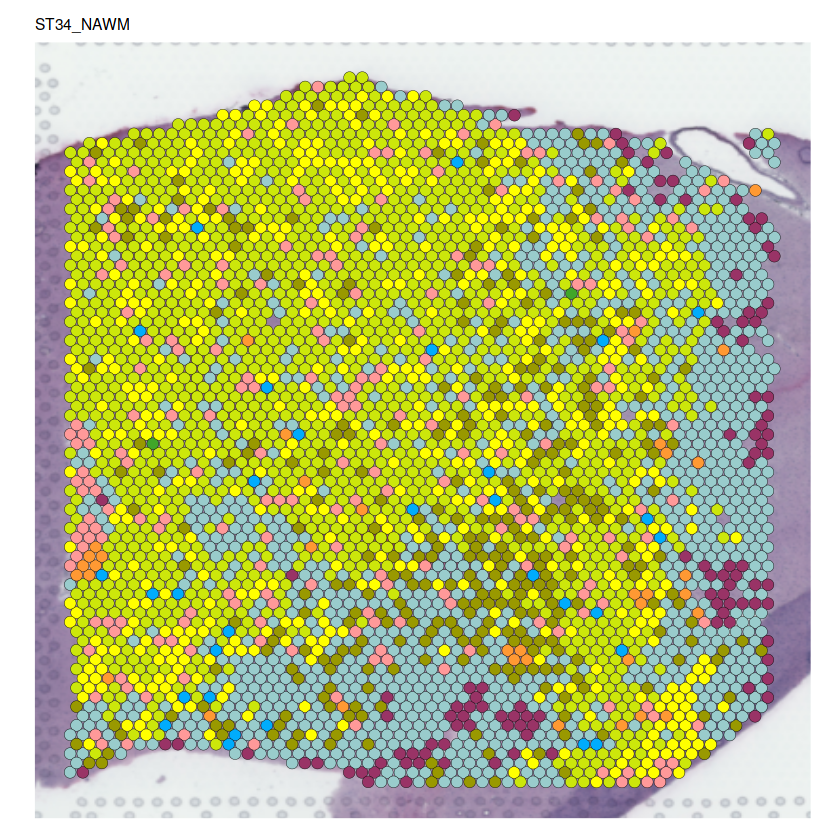

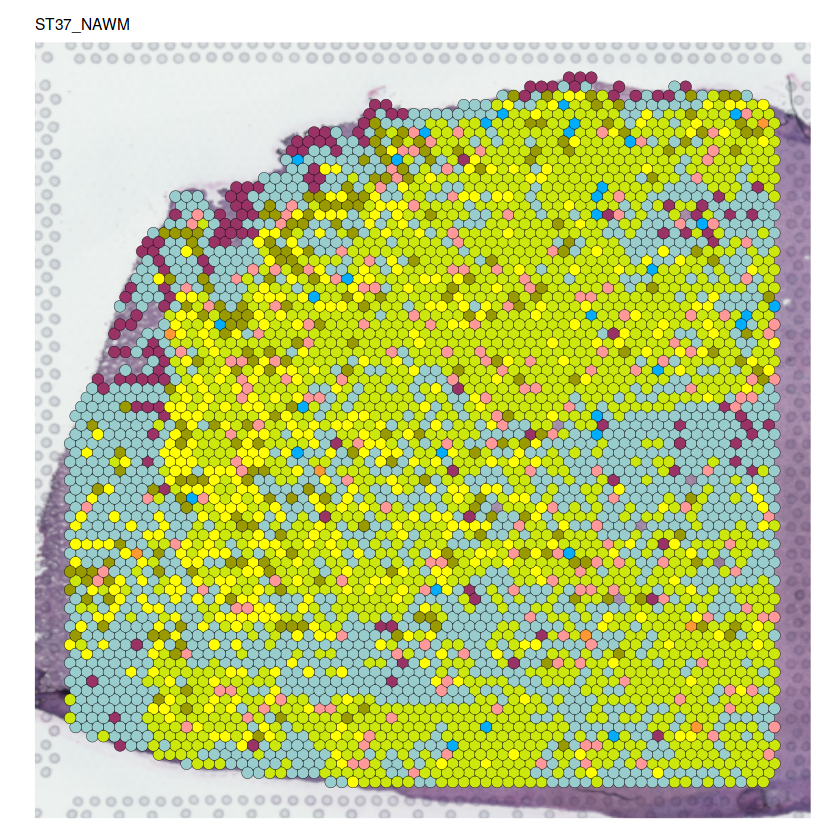

...

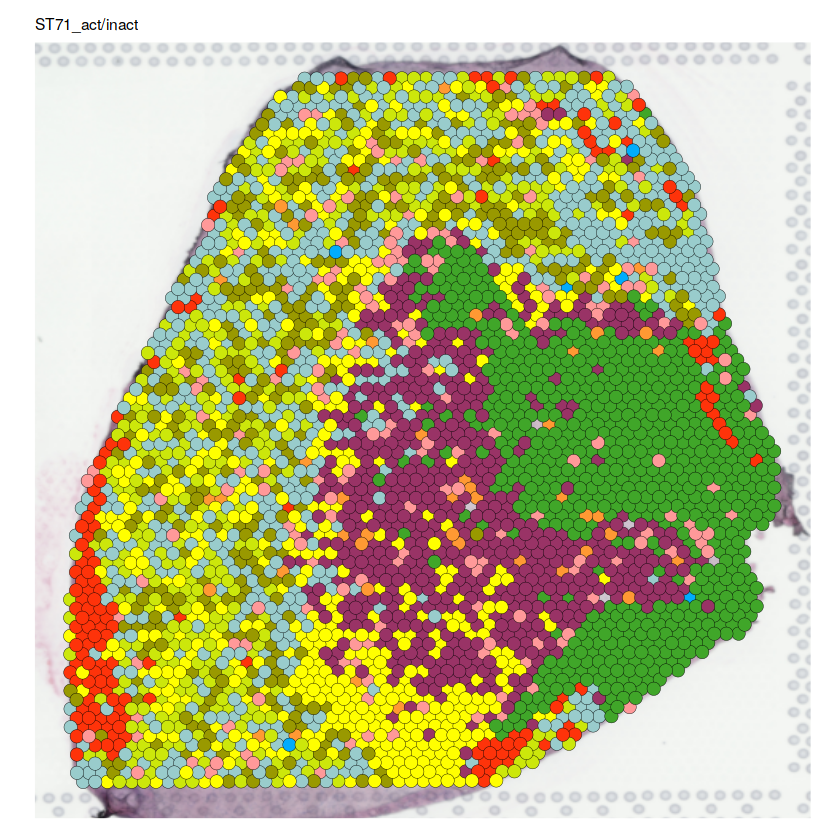

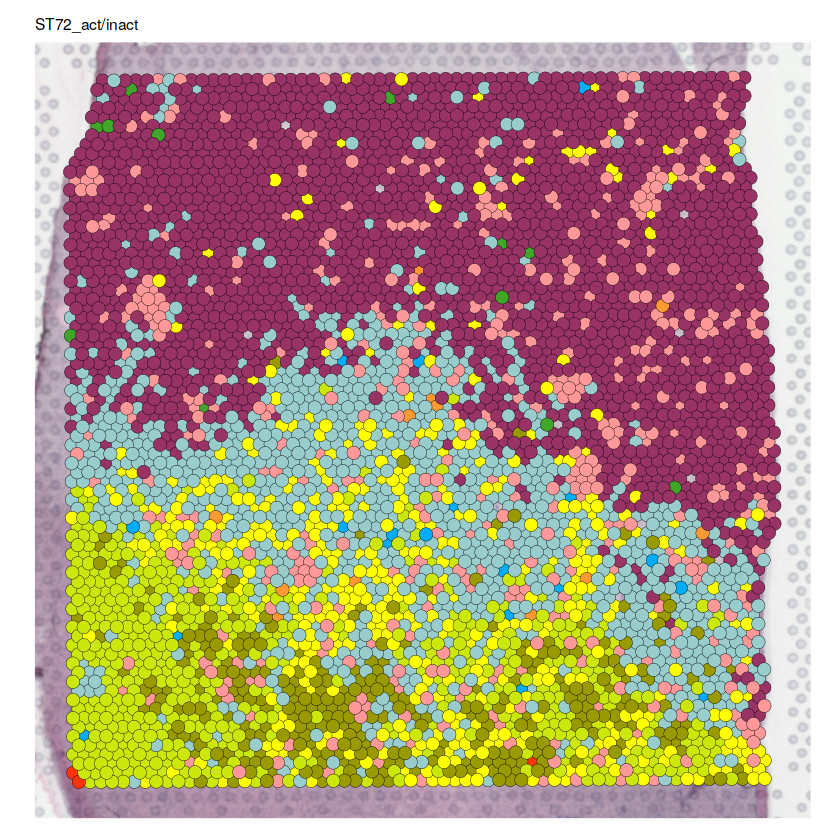

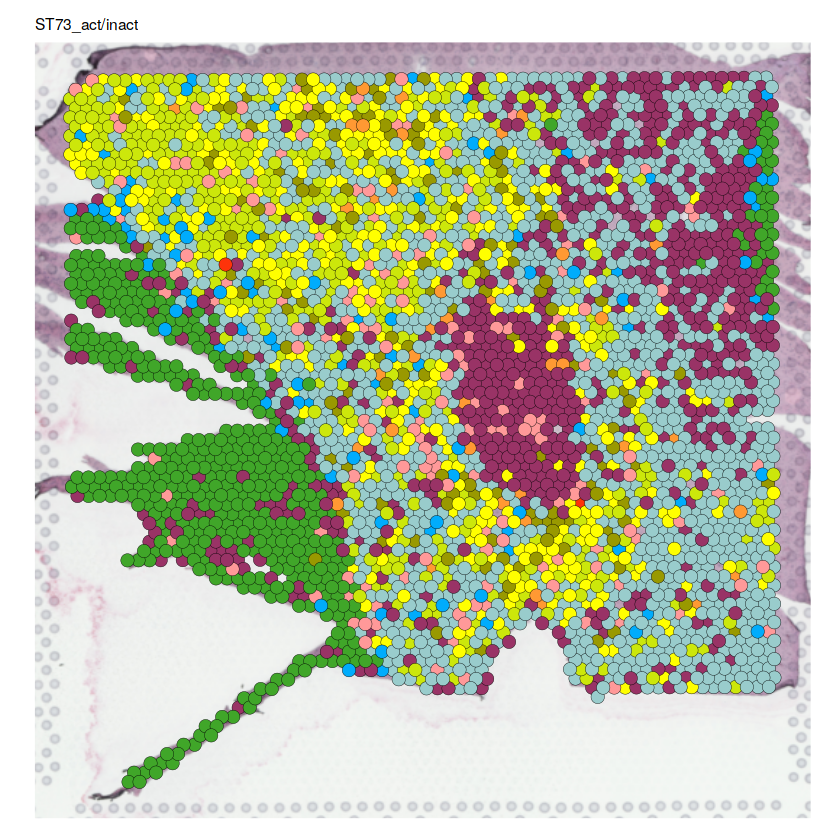

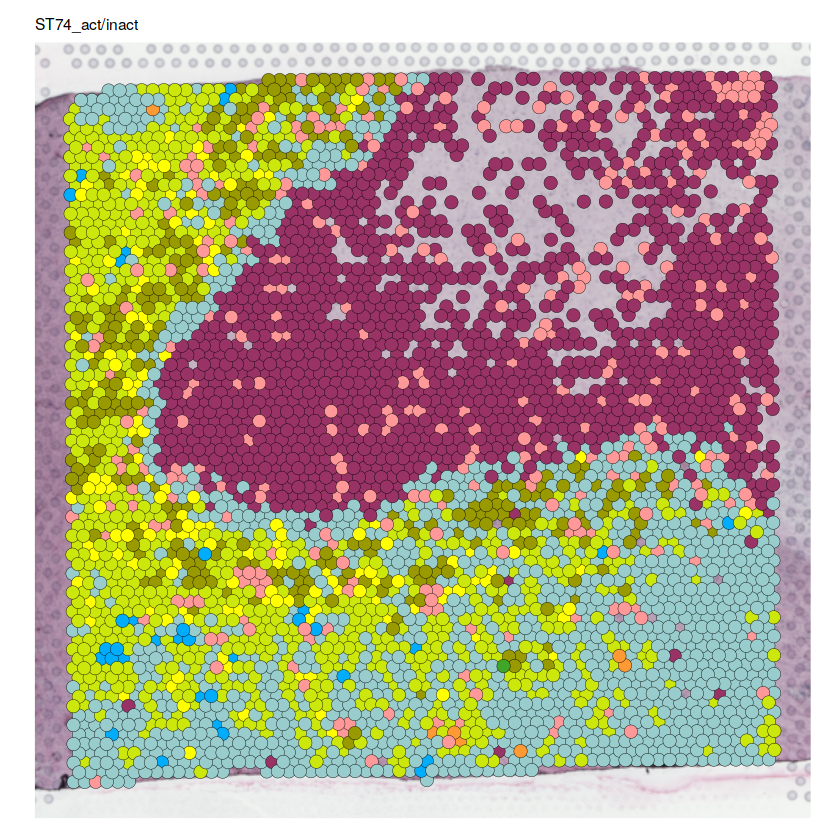

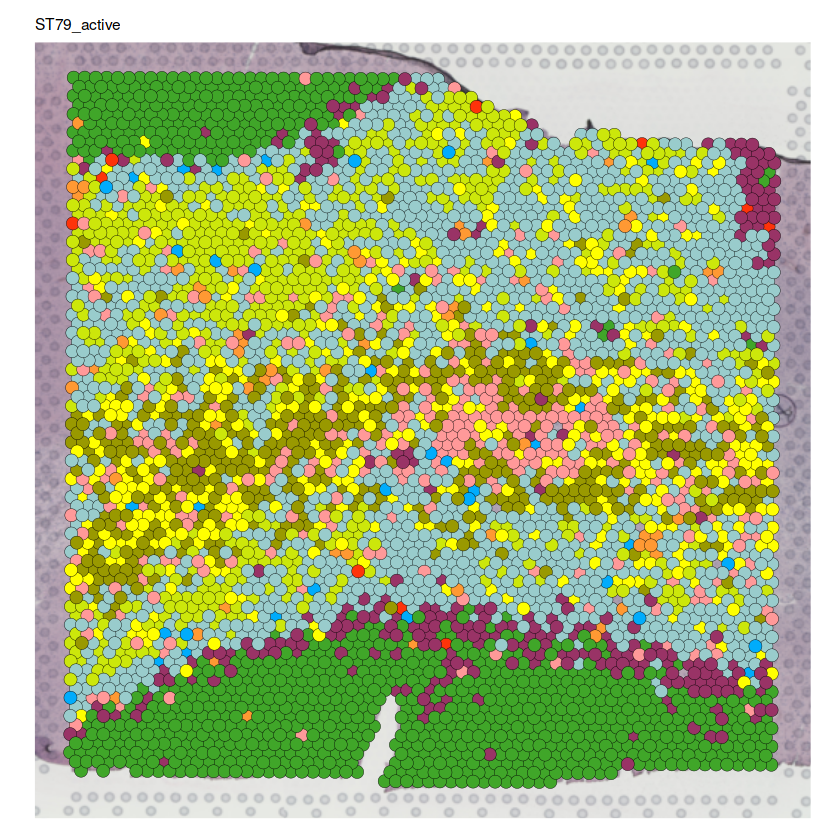

In [11]:
datasets$orig.ident <- paste(st.integrated$sample_ID, st.integrated$Group, sep = "_")
unique(datasets$orig.ident)

samples <- names(datasets@images)
length(samples)

ST_ID <- unique(datasets$orig.ident)
length(ST_ID)

plot_list = NULL
for (k in 1:length(samples)){
    sample <- as.character(samples[k])
    plot <- SpatialDimPlot(datasets, images = sample, 
                           group.by = "seurat_clusters", 
                           cols = ucols, 
                           pt.size.factor = 1.6,
                           alpha = c(1, 1),
                           image.alpha = 1,
                           stroke = 0.25,
                           combine = TRUE) 
    plot <- plot + NoLegend() + ggtitle(as.character(ST_ID[k])) + 
                   theme(plot.title = element_text(size = 9))
    plot_list[[k]] <- plot
    print(plot)
}

In [12]:
#-------------------------- Violins of lesion genes --------------------------
DefaultAssay(datasets) <- "Spatial"

p1 <- VlnPlot(datasets, features = c('CNP'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() #, 'APOE', 'GPNMB', "FTL"
p1a <- VlnPlot(datasets, features = c('SPP1'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() #, 'APOE', 'GPNMB', "FTL"
p2 <- VlnPlot(datasets, features = c('MT-ND4L'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() #, '', '', "FTL"
p3 <- VlnPlot(datasets, features = c('DTNA'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() #, '', '', "FTL"

p5 <- VlnPlot(datasets, features = c('C3'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend()#, 'APOE', 'GPNMB', "FTL"
p6 <- VlnPlot(datasets, features = c('CHI3L1'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() 
p7 <- VlnPlot(datasets, features = c('APOE'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() 
# cluster 3
p8 <- VlnPlot(datasets, features = c('IGLC2'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() 
p9 <- VlnPlot(datasets, features = c('IGKC'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() 
p10 <- VlnPlot(datasets, features = c('DCN'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() 
# cluster 4
p11 <- VlnPlot(datasets, features = c('CLDN11'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() 
#cluster 5

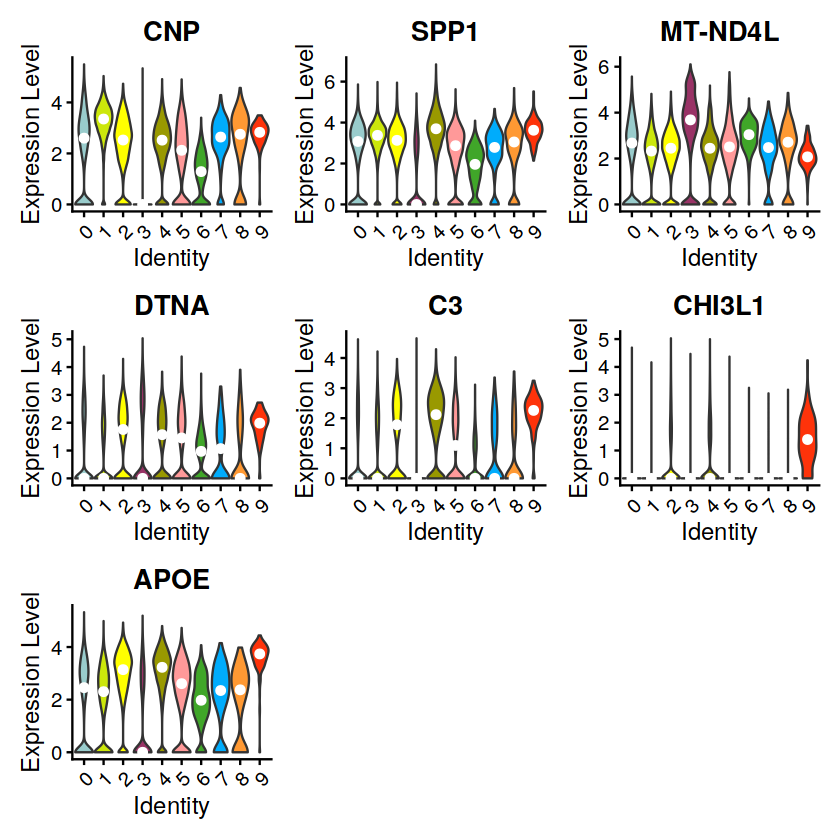

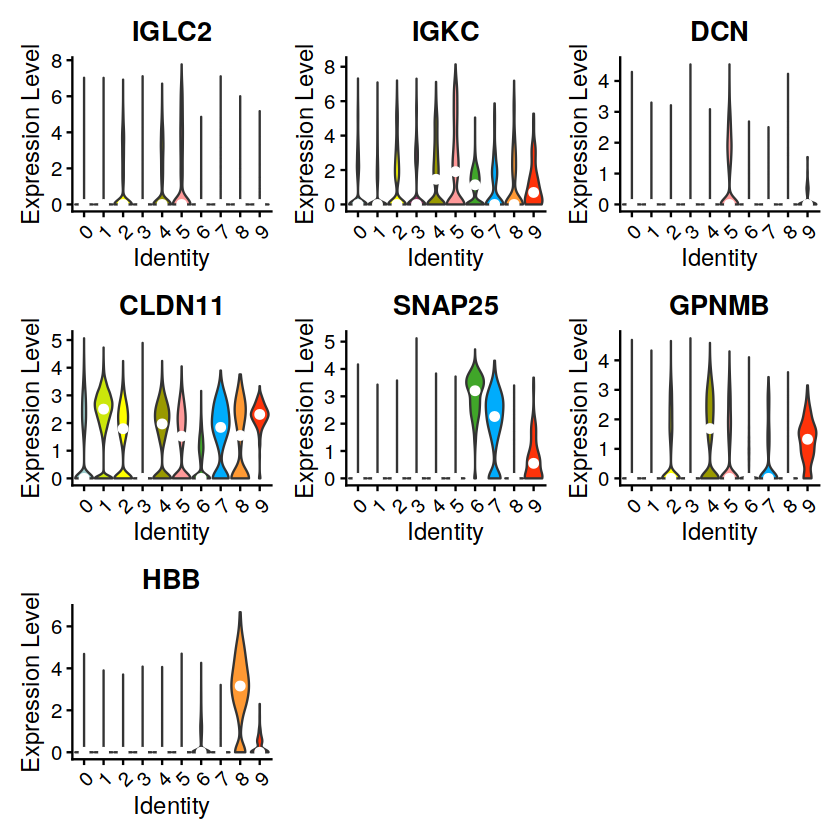

In [13]:
p12 <- VlnPlot(datasets, features = c('SNAP25'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() 
p13 <- VlnPlot(datasets, features = c('GPNMB'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() 
# cluster6
p14 <- VlnPlot(datasets, features = c('HBB'), pt.size = 0, cols = ucols) + stat_summary(fun = median, geom = "point", size = 2, color = 'white') + NoLegend() 


wrap_plots(p1, p1a, p2, p3, p5, p6, p7, ncol = 3)
wrap_plots(p8, p9, p10, p11, p12, p13, p14, ncol = 3) 

In [ ]:
pdf("./Routput/Seurat/Clustering/split_by_plots.pdf", width = 20)
DimPlot(datasets, reduction = "umap", cols = ucols, label = T)  + theme_void()
DimPlot(datasets, pt.size = 0.4, split.by = c("Group"), cols = group_cols) + theme_void()
DimPlot(datasets, pt.size = 0.4, split.by = "sample_name") + theme_void() # donor id
DimPlot(datasets, pt.size = 0.4, split.by = "slide") + theme_void() # slide id
dev.off()

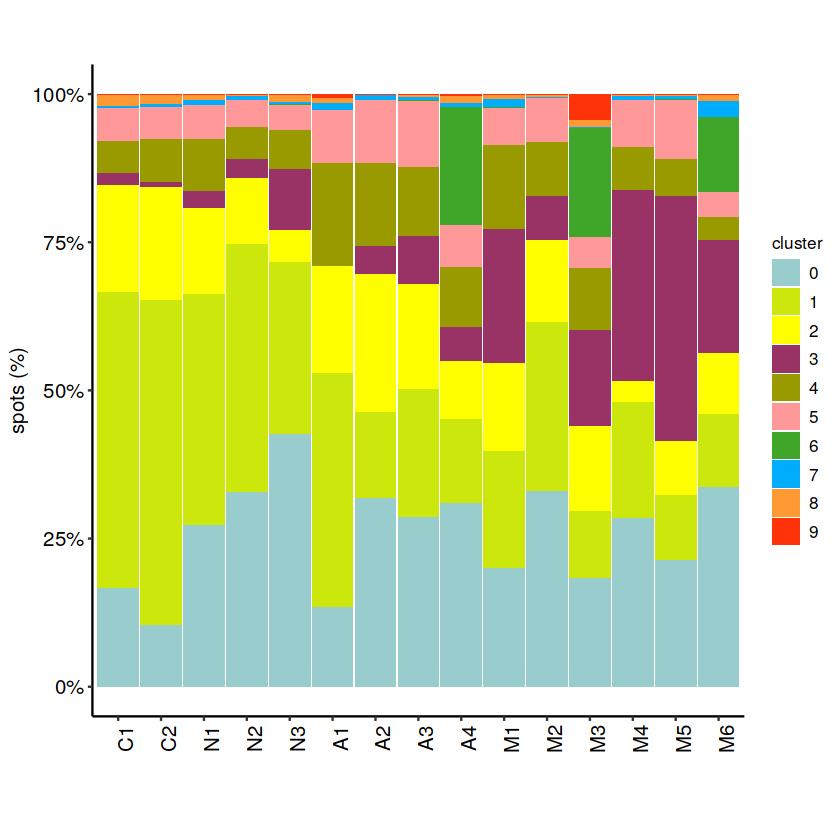

In [14]:
# order the donors in groups to make a bargraph - check donor effect

ST <- datasets
# barplot by sample

barp_perc <- function(dataframe){
 ggplot(data = dataframe, aes(x=variable, y= percentage, fill = cluster)) +
   geom_bar(stat = "identity", position = position_fill(reverse = TRUE), width = 0.95) +
   scale_fill_manual(values = ucols) +
   xlab('') +
   ylab('spots (%)') +
   scale_y_continuous(labels=scales::percent) +
   ggplot.theme +
   theme(axis.text.x = element_text(angle = 90))
}

# barplot per donor
rel_counts <- table(ST$seurat_clusters, ST$manuscript_ID)

for (i in 1:ncol(rel_counts)){
 rel_counts[,i] <- (prop.table(rel_counts[,i]))*100
}
dg <- as.data.frame(rel_counts)
colnames(dg) <- c("cluster", "variable", "percentage")

barp_perc(dg)

In [19]:
### manual decision point,
#remove cluster 9 as it is sample-M3 specific. 
#Remove cluster 6 as it reflects the spots above GM tissue and we would like to focus analysis on WM spots
#Remove cluster 7 as it reflects the spots with a mix of GM/WM tissue.
ncol(datasets)
datasets_new <- subset(datasets, idents = c( "6", "7", "9"), invert = TRUE)
ncol(datasets_new)



[1] 58271

[1] 55519

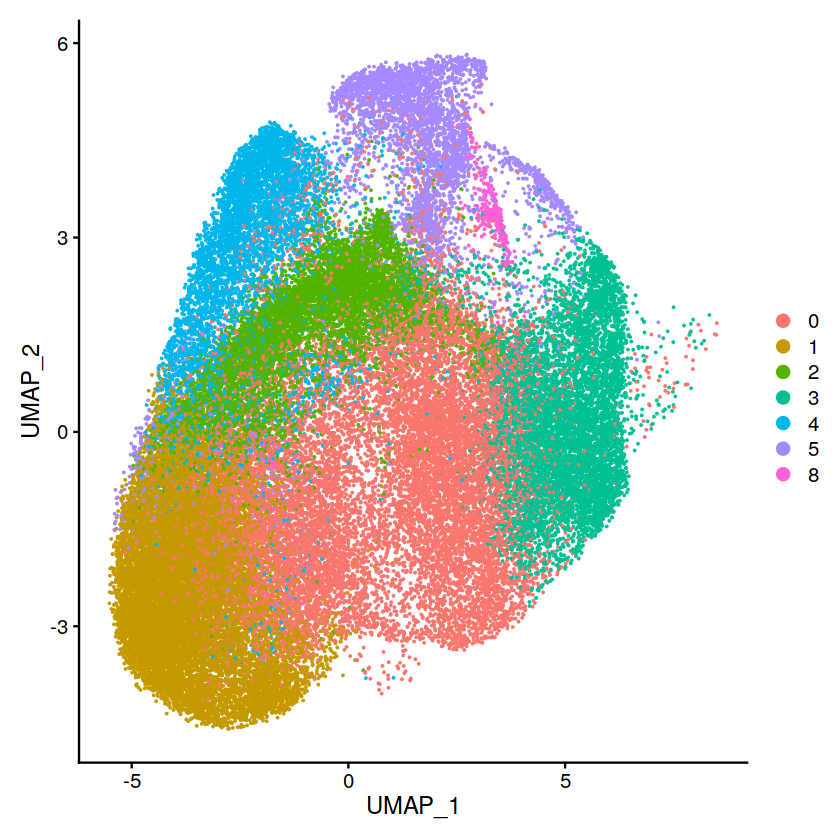

In [20]:
DimPlot(datasets_new)

In [21]:

saveRDS(datasets_new, file = paste0("./RData/seurat/2.WM.integrated_scaled_filtered_filtered.rds"))

In [2]:
sessionInfo()

R version 4.2.0 (2022-04-22)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: Ubuntu 20.04.5 LTS

Matrix products: default
BLAS/LAPACK: /data/bcn/p283607/anaconda3/envs/R4.2/lib/libopenblasp-r0.3.21.so

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] stats     graphics  grDevices utils     datasets  methods   base     

other attached packages:
[1] RColorBrewer_1.1-3 dplyr_1.1.4        future_1.33.0      patchwork_1.1.3   
[5] ggplot2_3.4.4      hdf5r_1.3.7        SeuratObject_5.0.1 Seurat_4.3.0      

loaded via a namespace (and not attached):
  [1] Rtsne_0.16             colorspace_2.1-0       deldir_2.0-2          
  [4] ellipsis_0.3.2   